In [77]:
import geopandas as gpd
import matplotlib.pyplot as plt

In [78]:
db = gpd.read_file("~/data/shared/sandiego_tracts.gpkg")

In [79]:
db.head()

,GEOID,median_age,total_pop,total_pop_white,tt_work,hh_total,hh_female,total_bachelor,median_hh_income,income_gini,...,state,county,tract,area_sqm,pct_rented,pct_hh_female,pct_bachelor,pct_white,sub_30,geometry
0,06073018300,37.1,2590.0,2375.0,1299.0,2590.0,137.0,0.0,62500.0,0.5355,...,06,073,018300,2.876449,0.373913,0.052896,0.000000,0.916988,False,"POLYGON ((-13069450.120 3922380.770, -13069175..."
1,06073018601,41.2,5147.0,4069.0,1970.0,5147.0,562.0,24.0,88165.0,0.4265,...,06,073,018601,4.548797,0.205144,0.109190,0.004663,0.790558,False,"POLYGON ((-13067719.770 3922939.420, -13067631..."
2,06073017601,54.4,5595.0,4925.0,1702.0,5595.0,442.0,34.0,110804.0,0.4985,...,06,073,017601,8.726275,0.279029,0.078999,0.006077,0.880250,False,"POLYGON ((-13058166.110 3907247.690, -13058140..."
3,06073019301,42.3,7026.0,5625.0,3390.0,7026.0,638.0,46.0,100539.0,0.4003,...,06,073,019301,3.519743,0.196512,0.090806,0.006547,0.800598,False,"POLYGON ((-13056896.290 3925255.610, -13056868..."
4,06073018700,21.8,40402.0,30455.0,24143.0,40402.0,2456.0,23.0,41709.0,0.3196,...,06,073,018700,559.150793,0.949887,0.060789,0.000569,0.753799,False,"POLYGON ((-13090788.510 3946435.430, -13090736..."


<Axes: >

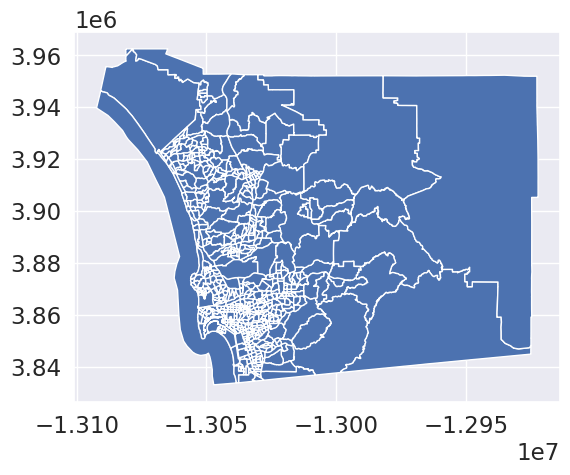

In [80]:
db.plot()

In [81]:
cluster_variables = [
    "median_house_value",  # Median house value
    "pct_white",  # % tract population that is white
    "pct_rented",  # % households that are rented
    "pct_hh_female",  # % female-led households
    "pct_bachelor",  # % tract population with a Bachelors degree
    "median_no_rooms",  # Median n. of rooms in the tract's households
    "income_gini",  # Gini index measuring tract wealth inequality
    "median_age",  # Median age of tract population
    "tt_work",  # Travel time to work
]

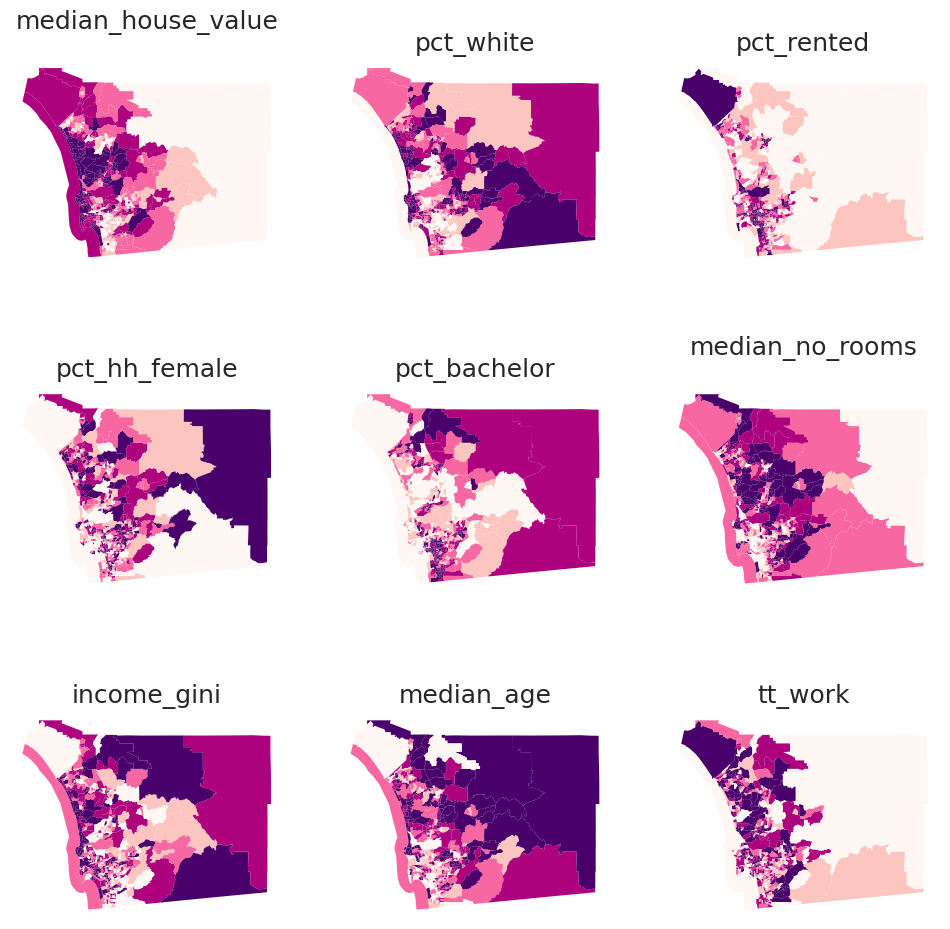

In [82]:
f, axs = plt.subplots(nrows=3, ncols=3, figsize=(12, 12))
# Make the axes accessible with single indexing
axs = axs.flatten()
# Start a loop over all the variables of interest
for i, col in enumerate(cluster_variables):
    # select the axis where the map will go
    ax = axs[i]
    # Plot the map
    db.plot(
        column=col,
        ax=ax,
        scheme="Quantiles",
        linewidth=0,
        cmap="RdPu",
    )
    # Remove axis clutter
    ax.set_axis_off()
    # Set the axis title to the name of variable being plotted
    ax.set_title(col)
# Display the figure
plt.show()

In [ ]:
import seaborn

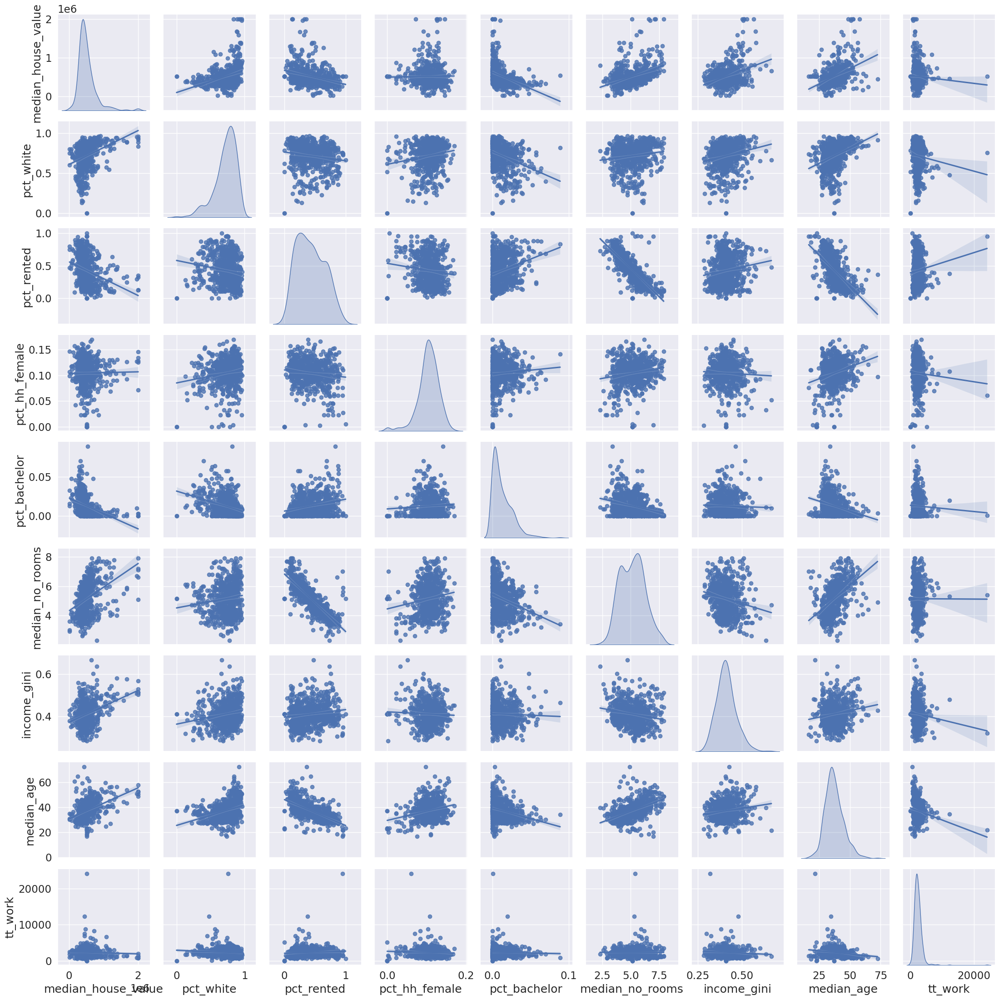

In [84]:
_ = seaborn.pairplot(
    db[cluster_variables], kind="reg", diag_kind="kde"
)

In [85]:
db[["income_gini", "median_house_value"]].head()

,income_gini,median_house_value
0,0.5355,732900.000000
1,0.4265,473800.000000
2,0.4985,930600.000000
3,0.4003,478500.000000
4,0.3196,515570.896382


In [86]:
from sklearn import metrics

In [87]:
metrics.pairwise_distances(
    db[["income_gini", "median_house_value"]].head()
).round(4)

array([[     0.    , 259100.    , 197700.    , 254400.    , 217329.1036],
       [259100.    ,      0.    , 456800.    ,   4700.    ,  41770.8964],
       [197700.    , 456800.    ,      0.    , 452100.    , 415029.1036],
       [254400.    ,   4700.    , 452100.    ,      0.    ,  37070.8964],
       [217329.1036,  41770.8964, 415029.1036,  37070.8964,      0.    ]])

In [88]:
from sklearn.preprocessing import robust_scale

In [89]:
db_scaled = robust_scale(db[cluster_variables])

In [90]:
cluster_variables

['median_house_value',
 'pct_white',
 'pct_rented',
 'pct_hh_female',
 'pct_bachelor',
 'median_no_rooms',
 'income_gini',
 'median_age',
 'tt_work']

In [91]:
metrics.pairwise_distances(
    db_scaled[:5,:]
).round(4)

array([[ 0.    ,  3.3787,  2.792 ,  3.6903, 19.0006],
       [ 3.3787,  0.    ,  2.9241,  1.3899, 18.3732],
       [ 2.792 ,  2.9241,  0.    ,  3.1615, 18.9427],
       [ 3.6903,  1.3899,  3.1615,  0.    , 17.19  ],
       [19.0006, 18.3732, 18.9427, 17.19  ,  0.    ]])

In [92]:
db_scaled

array([[ 1.16897565,  0.88747229, -0.07925532, ...,  1.93719258,
         0.1011236 , -0.6982584 ],
       [ 0.08123426,  0.20084202, -0.54215204, ...,  0.28755202,
         0.56179775, -0.15471851],
       [ 1.99895046,  0.68795166, -0.33950017, ...,  1.37722285,
         2.04494382, -0.37181045],
       ...,
       [-0.02581864,  1.04512769, -0.79870967, ..., -1.11842603,
         0.93258427, -0.04860267],
       [ 0.20969773,  0.56397715, -0.83360459, ..., -0.03783579,
         1.1011236 , -0.63831511],
       [-1.24118388,  0.4812156 , -0.84270269, ...,  0.51608021,
         2.74157303, -1.1891454 ]])

In [93]:
db_scaled.shape

(628, 9)

## k-means

In [94]:
from sklearn.cluster import KMeans

In [95]:
kmeans = KMeans(n_clusters=5)

import numpy as np
np.random.seed(1234)
k5cls = kmeans.fit(db_scaled)

In [96]:
k5cls.labels_[:5]

array([2, 1, 3, 1, 4], dtype=int32)

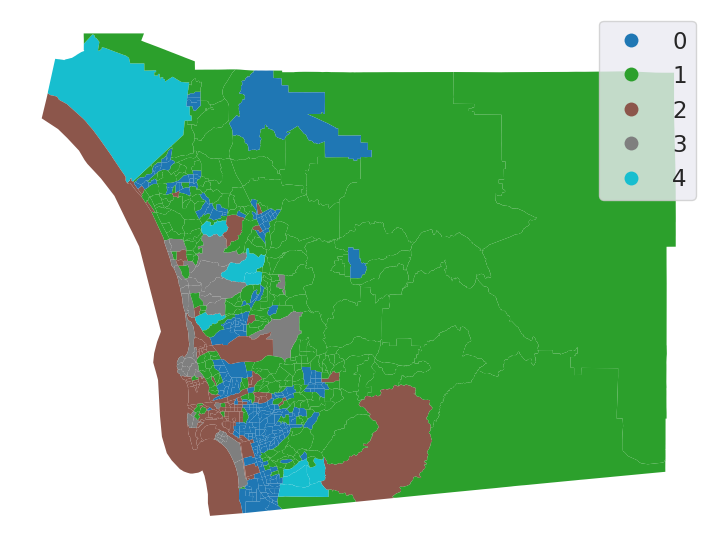

In [97]:
# Assign labels into a column
db["k5cls"] = k5cls.labels_
# Set up figure and ax
f, ax = plt.subplots(1, figsize=(9, 9))
# Plot unique values choropleth including
# a legend and with no boundary lines
db.plot(
    column="k5cls", categorical=True, legend=True, linewidth=0, ax=ax
)
# Remove axis
ax.set_axis_off()
# Display the map
plt.show()

In [98]:
# Group data table by cluster label and count observations
k5sizes = db.groupby("k5cls").size()
k5sizes



k5cls
0    248
1    244
2     88
3     39
4      9
dtype: int64

In [99]:
# Dissolve areas by Cluster, aggregate by summing,
# and keep column for area
areas = db.dissolve(by="k5cls", aggfunc="sum")["area_sqm"]
areas

k5cls
0     739.184478
1    8622.481814
2    1335.721492
3     315.428301
4     708.956558
Name: area_sqm, dtype: float64

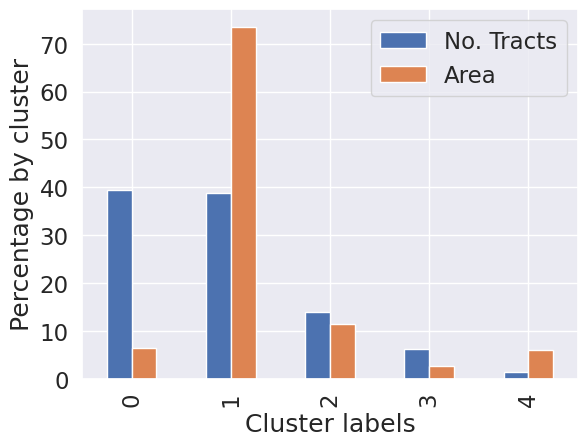

In [100]:
import pandas
# Bind cluster figures in a single table
area_tracts = pandas.DataFrame({"No. Tracts": k5sizes, "Area": areas})
# Convert raw values into percentages
area_tracts = area_tracts * 100 / area_tracts.sum()
# Bar plot
ax = area_tracts.plot.bar()
# Rename axes
ax.set_xlabel("Cluster labels")
ax.set_ylabel("Percentage by cluster");

In [101]:
# Group table by cluster label, keep the variables used
# for clustering, and obtain their mean
k5means = db.groupby("k5cls")[cluster_variables].mean()
# Transpose the table and print it rounding each value
# to three decimals
k5means.T.round(3)

k5cls,0,1,2,3,4
median_house_value,356997.331,538463.934,544888.738,1292905.256,609385.655
pct_white,0.620,0.787,0.741,0.874,0.583
pct_rented,0.551,0.270,0.596,0.275,0.377
pct_hh_female,0.108,0.114,0.065,0.109,0.095
pct_bachelor,0.023,0.007,0.005,0.002,0.007
median_no_rooms,4.623,5.850,4.153,6.100,5.800
income_gini,0.400,0.397,0.449,0.488,0.391
median_age,32.783,42.057,32.590,46.356,33.500
tt_work,2238.883,2244.320,2349.511,1746.410,9671.556


In [102]:
# Index db on cluster ID
tidy_db = db.set_index("k5cls")
# Keep only variables used for clustering
tidy_db = tidy_db[cluster_variables]
# Stack column names into a column, obtaining
# a "long" version of the dataset
tidy_db = tidy_db.stack()
# Take indices into proper columns
tidy_db = tidy_db.reset_index()
# Rename column names
tidy_db = tidy_db.rename(
    columns={"level_1": "Attribute", 0: "Values"}
)
# Check out result
tidy_db.head()

,k5cls,Attribute,Values
0,2,median_house_value,732900.000000
1,2,pct_white,0.916988
2,2,pct_rented,0.373913
3,2,pct_hh_female,0.052896
4,2,pct_bachelor,0.000000


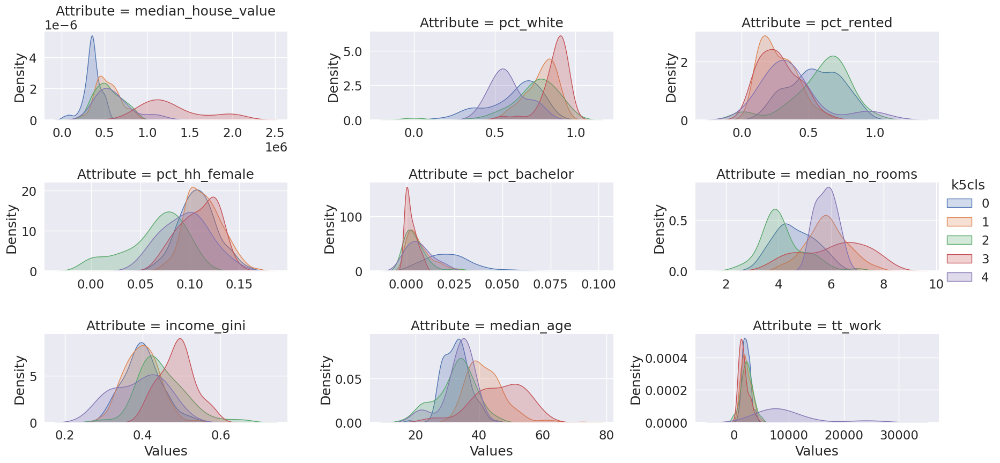

In [103]:
# Scale fonts to make them more readable
seaborn.set(font_scale=1.5)
# Setup the facets
facets = seaborn.FacetGrid(
    data=tidy_db,
    col="Attribute",
    hue="k5cls",
    sharey=False,
    sharex=False,
    aspect=2,
    col_wrap=3,
)
# Build the plot from `sns.kdeplot`
_ = facets.map(seaborn.kdeplot, "Values", fill=True).add_legend()

## Agglomerative Clustering

In [105]:
from sklearn.cluster import AgglomerativeClustering

In [106]:
# Set seed for reproducibility
np.random.seed(0)
# Initialize the algorithm
model = AgglomerativeClustering(linkage="ward", n_clusters=5)
# Run clustering
model.fit(db_scaled)
# Assign labels to main data table
db["ward5"] = model.labels_

In [107]:
ward5sizes = db.groupby("ward5").size()
ward5sizes

ward5
0    198
1     10
2     48
3    287
4     85
dtype: int64

In [108]:
ward5means = db.groupby("ward5")[cluster_variables].mean()
ward5means.T.round(3)

ward5,0,1,2,3,4
median_house_value,365932.350,625607.090,1202087.604,503608.711,503905.198
pct_white,0.589,0.598,0.871,0.770,0.766
pct_rented,0.573,0.360,0.285,0.287,0.657
pct_hh_female,0.105,0.098,0.107,0.112,0.076
pct_bachelor,0.023,0.006,0.002,0.009,0.006
median_no_rooms,4.566,5.860,6.010,5.738,3.904
income_gini,0.405,0.394,0.480,0.394,0.442
median_age,31.955,34.250,45.196,40.695,33.540
tt_work,2181.970,9260.400,1766.354,2268.718,2402.671


In [109]:
# Index db on cluster ID
tidy_db = db.set_index("ward5")
# Keep only variables used for clustering
tidy_db = tidy_db[cluster_variables]
# Stack column names into a column, obtaining
# a "long" version of the dataset
tidy_db = tidy_db.stack()
# Take indices into proper columns
tidy_db = tidy_db.reset_index()
# Rename column names
tidy_db = tidy_db.rename(
    columns={"level_1": "Attribute", 0: "Values"}
)
# Check out result
tidy_db.head()

,ward5,Attribute,Values
0,4,median_house_value,732900.000000
1,4,pct_white,0.916988
2,4,pct_rented,0.373913
3,4,pct_hh_female,0.052896
4,4,pct_bachelor,0.000000


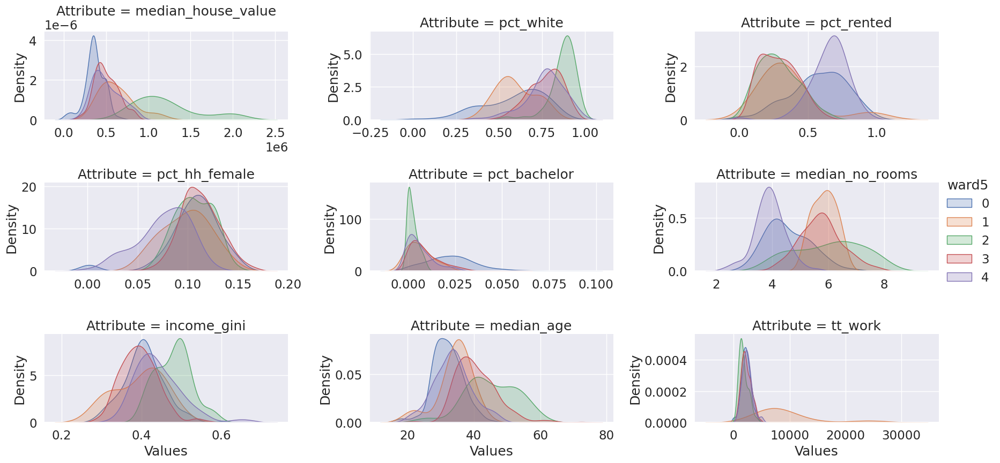

In [110]:
# Setup the facets
facets = seaborn.FacetGrid(
    data=tidy_db,
    col="Attribute",
    hue="ward5",
    sharey=False,
    sharex=False,
    aspect=2,
    col_wrap=3,
)
# Build the plot as a `sns.kdeplot`
facets.map(seaborn.kdeplot, "Values", fill=True).add_legend();

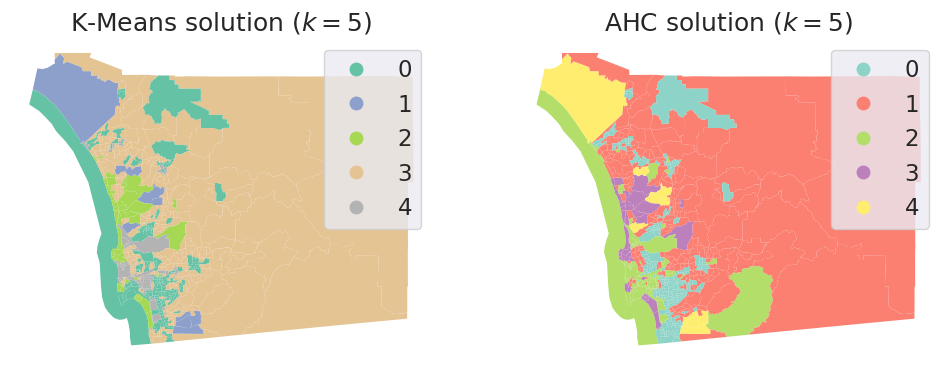

In [111]:
db["ward5"] = model.labels_
# Set up figure and ax
f, axs = plt.subplots(1, 2, figsize=(12, 6))

### K-Means ###
ax = axs[0]
# Plot unique values choropleth including
# a legend and with no boundary lines
db.plot(
    column="ward5",
    categorical=True,
    cmap="Set2",
    legend=True,
    linewidth=0,
    ax=ax,
)
# Remove axis
ax.set_axis_off()
# Add title
ax.set_title("K-Means solution ($k=5$)")

### AHC ###
ax = axs[1]
# Plot unique values choropleth including
# a legend and with no boundary lines
db.plot(
    column="k5cls",
    categorical=True,
    cmap="Set3",
    legend=True,
    linewidth=0,
    ax=ax,
)
# Remove axis
ax.set_axis_off()
# Add title
ax.set_title("AHC solution ($k=5$)")

# Display the map
plt.show()

In [112]:
from sklearn.metrics import rand_score

### Rand index

- $a$ the number of pairs that are in the same cluster in K-Means and AHC
- $b$ the number of pairs that are in different clusters in k-Means and in different subsets in AHC
- $c$ the number of pairs that are in the same cluster in K-Means and in different clusters in AHC
- $d$ the number of pairs that are in different clusters in K-Means and in the same cluster in AHC

$$R = \frac{a+b}{a+b+c+d} = \frac{a+b}{n(n-1)/2}$$

In [113]:
rand_score(db.k5cls, db.ward5)

0.8152053556009305

### Silhouette Coefficient

- $a$: The mean distance between a sample and all other points in the same cluster
- $b$: The mean distance between a sample and all other points in the next nearest cluster.

$$s = \frac{b-a}{max(a,b)}$$

- $-1 \le s \le 1$

In [114]:
from sklearn.metrics import silhouette_score

In [115]:
silhouette_score(db_scaled, db.k5cls)

0.19290802579312513

In [116]:
silhouette_score(db_scaled, db.ward5)

0.16230352315230728

In [117]:
from sklearn.metrics import silhouette_samples

In [118]:
s_kmeans = silhouette_samples(db_scaled, db.k5cls)

In [119]:
db['s_kmeans'] = s_kmeans

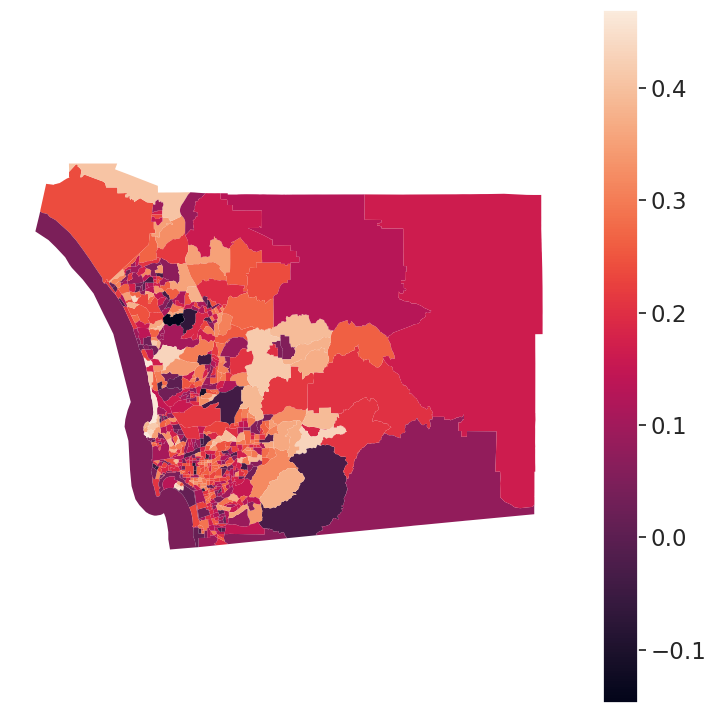

In [120]:

# Set up figure and ax
f, ax = plt.subplots(1, figsize=(9, 9))
# Plot unique values choropleth including
# a legend and with no boundary lines
db.plot(
    column="s_kmeans",  legend=True, linewidth=0, ax=ax
)
# Remove axis
ax.set_axis_off()
# Display the map
plt.show()

## How many Clusters?

set a neighborhood size = 8000

In [122]:
db.total_pop.sum()

3283665.0

In [123]:
n_hoods = int(db.total_pop.sum() / 8000)

In [124]:
n_hoods

410

In [126]:
kmeans = KMeans(n_clusters=n_hoods)

import numpy as np
np.random.seed(1234)
k410cls = kmeans.fit(db_scaled)

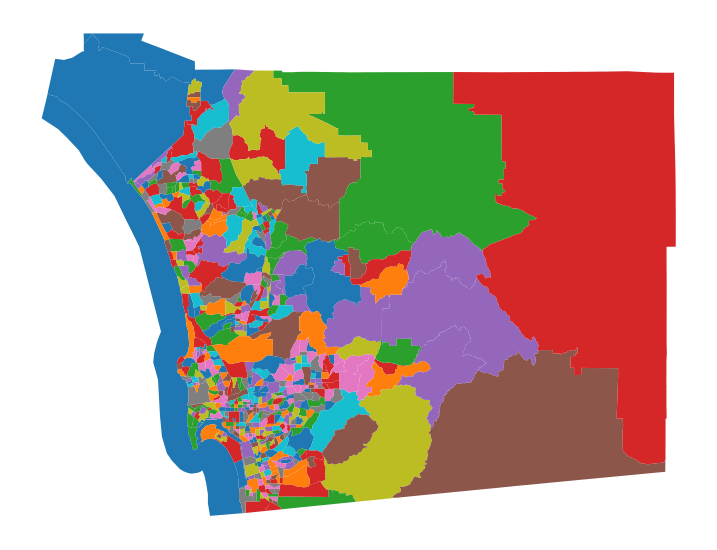

In [127]:
# Assign labels into a column
db["k410cls"] = k410cls.labels_
# Set up figure and ax
f, ax = plt.subplots(1, figsize=(9, 9))
# Plot unique values choropleth including
# a legend and with no boundary lines
db.plot(
    column="k410cls", categorical=True, legend=False, linewidth=0, ax=ax
)
# Remove axis
ax.set_axis_off()
# Display the map
plt.show()

<Axes: >

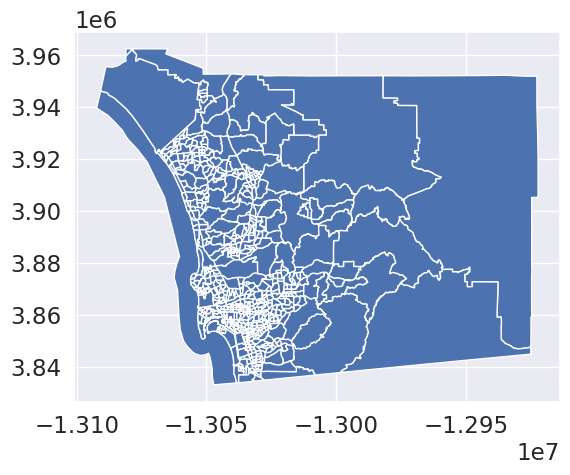

In [128]:
db.dissolve(by='k410cls').plot()

In [129]:
db.groupby(by='k410cls').count().sort_values(by='GEOID', ascending=False)

,GEOID,median_age,total_pop,total_pop_white,tt_work,hh_total,hh_female,total_bachelor,median_hh_income,income_gini,...,area_sqm,pct_rented,pct_hh_female,pct_bachelor,pct_white,sub_30,geometry,k5cls,ward5,s_kmeans
k410cls,,,,,,,,,,,,,,,,,,,,,
94,7,7,7,7,7,7,7,7,7,7,...,7,7,7,7,7,7,7,7,7,7
7,6,6,6,6,6,6,6,6,6,6,...,6,6,6,6,6,6,6,6,6,6
82,6,6,6,6,6,6,6,6,6,6,...,6,6,6,6,6,6,6,6,6,6
264,5,5,5,5,5,5,5,5,5,5,...,5,5,5,5,5,5,5,5,5,5
149,5,5,5,5,5,5,5,5,5,5,...,5,5,5,5,5,5,5,5,5,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
179,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
178,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
177,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1


<Axes: >

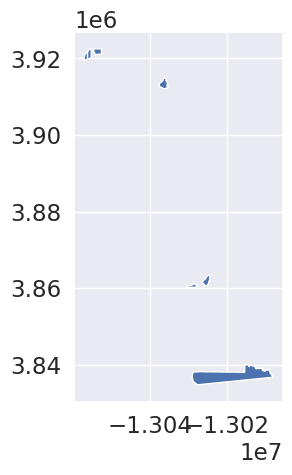

In [130]:
db[db.k410cls==94].plot()

In [136]:
np.random.seed(0)
# Initialize the algorithm
model = AgglomerativeClustering(linkage="ward", n_clusters=n_hoods)
# Run clustering
model.fit(db_scaled)
# Assign labels to main data table
db["ward410"] = model.labels_

In [137]:
silhouette_score(db_scaled, db.k410cls)

0.09318913872845698

In [138]:
silhouette_score(db_scaled, db.ward410)

0.12442664189896505

## Regionalization

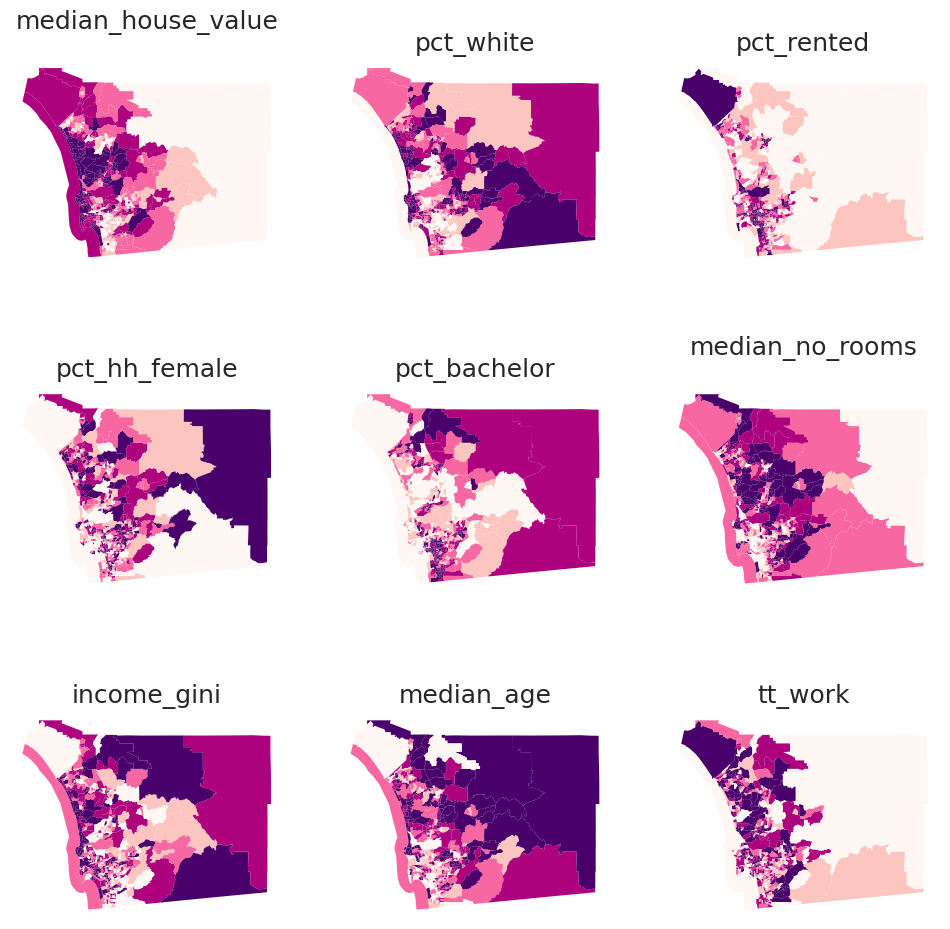

In [139]:
f, axs = plt.subplots(nrows=3, ncols=3, figsize=(12, 12))
# Make the axes accessible with single indexing
axs = axs.flatten()
# Start a loop over all the variables of interest
for i, col in enumerate(cluster_variables):
    # select the axis where the map will go
    ax = axs[i]
    # Plot the map
    db.plot(
        column=col,
        ax=ax,
        scheme="Quantiles",
        linewidth=0,
        cmap="RdPu",
    )
    # Remove axis clutter
    ax.set_axis_off()
    # Set the axis title to the name of variable being plotted
    ax.set_title(col)
# Display the figure
plt.show()

### Moran's I: Measuring Spatial Autocorrelation

In [140]:
from libpysal.weights import Queen
import numpy

w = Queen.from_dataframe(db)

/tmp/ipykernel_3781400/1403424482.py:4: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  w = Queen.from_dataframe(db)


In [141]:
from esda.moran import Moran
# Set seed for reproducibility
numpy.random.seed(123456)
# Calculate Moran's I for each variable
mi_results = [
    Moran(db[variable], w) for variable in cluster_variables
]
# Structure results as a list of tuples
mi_results = [
    (variable, res.I, res.p_sim)
    for variable, res in zip(cluster_variables, mi_results)
]
# Display on table
table = pandas.DataFrame(
    mi_results, columns=["Variable", "Moran's I", "P-value"]
).set_index("Variable")
table

,Moran's I,P-value
Variable,,
median_house_value,0.646618,0.001
pct_white,0.602079,0.001
pct_rented,0.451372,0.001
pct_hh_female,0.282239,0.001
pct_bachelor,0.433082,0.001
median_no_rooms,0.538996,0.001
income_gini,0.295064,0.001
median_age,0.381440,0.001
tt_work,0.102748,0.001


## Wards with Contiguity Constraint

In [142]:
# Set the seed for reproducibility
np.random.seed(123456)
# Specify cluster model with spatial constraint
model = AgglomerativeClustering(
    linkage="ward", connectivity=w.sparse, n_clusters=5
)
# Fit algorithm to the data
model.fit(db_scaled)

AgglomerativeClustering(connectivity=<628x628 sparse matrix of type '<class 'numpy.float64'>'
	with 4016 stored elements in Compressed Sparse Row format>,
                        n_clusters=5)

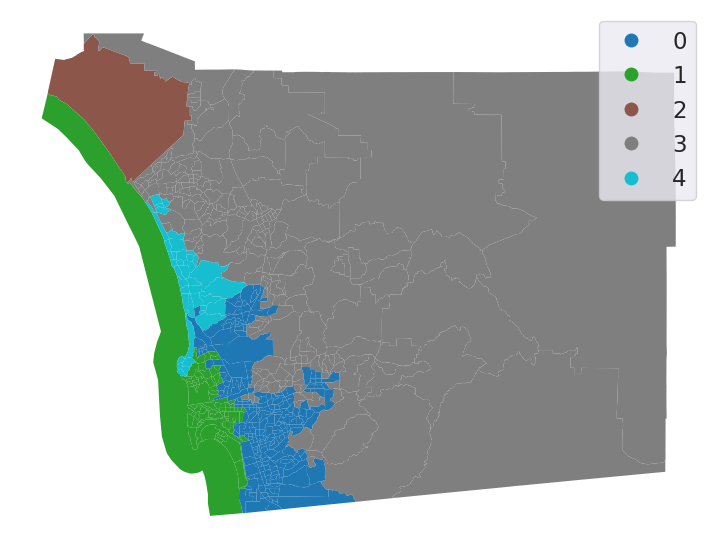

In [143]:
db["ward5wq"] = model.labels_
# Set up figure and ax
f, ax = plt.subplots(1, figsize=(9, 9))
# Plot unique values choropleth including a legend and with no boundary lines
db.plot(
    column="ward5wq",
    categorical=True,
    legend=True,
    linewidth=0,
    ax=ax,
)
# Remove axis
ax.set_axis_off()
# Display the map
plt.show()

## Max-p

> Future studies should consider consolidating counties using regionalization methods.57, 58
[Salerno et al. 2024](https://dom-pubs.onlinelibrary.wiley.com/doi/full/10.1111/dom.15488)

>  Future studies should consider regionalization methods, such as the Max-P-regions model23, to combine counties with small numbers of cases.
[Dong et al. 2023](https://www.nature.com/articles/s41598-023-30188-9)
>

Actually doing it:
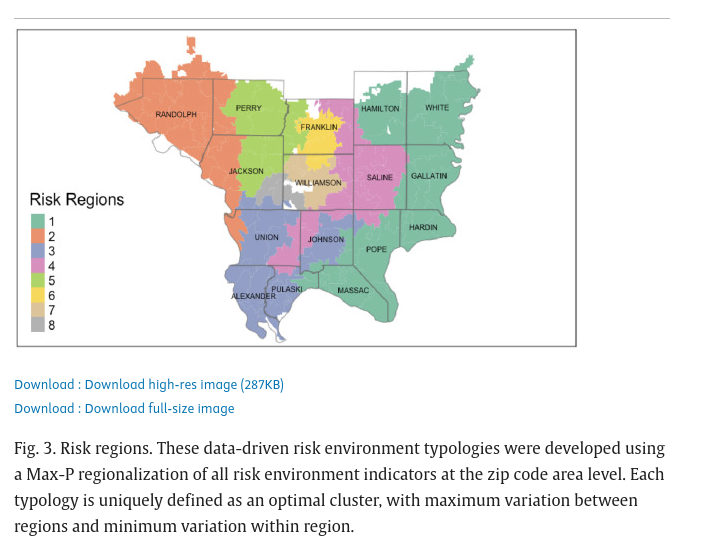

[Kolak et al. 2020](https://www.sciencedirect.com/science/article/pii/S0955395920300682)

In [144]:
from spopt.region import MaxPHeuristic as MaxP

In [145]:
db.total_pop

0       2590.0
1       5147.0
2       5595.0
3       7026.0
4      40402.0
        ...   
623     7848.0
624     3624.0
625     5261.0
626     3065.0
627     2693.0
Name: total_pop, Length: 628, dtype: float64

In [146]:
model = MaxP(db, w, cluster_variables, 'total_pop', 8000, top_n=2)

In [147]:
np.random.seed(1234)
model.solve()

In [148]:
db['maxp'] = model.labels_

In [149]:
db.groupby(by='maxp').count()

,GEOID,median_age,total_pop,total_pop_white,tt_work,hh_total,hh_female,total_bachelor,median_hh_income,income_gini,...,pct_bachelor,pct_white,sub_30,geometry,k5cls,ward5,s_kmeans,k410cls,ward410,ward5wq
maxp,,,,,,,,,,,,,,,,,,,,,
1,2,2,2,2,2,2,2,2,2,2,...,2,2,2,2,2,2,2,2,2,2
2,4,4,4,4,4,4,4,4,4,4,...,4,4,4,4,4,4,4,4,4,4
3,3,3,3,3,3,3,3,3,3,3,...,3,3,3,3,3,3,3,3,3,3
4,2,2,2,2,2,2,2,2,2,2,...,2,2,2,2,2,2,2,2,2,2
5,3,3,3,3,3,3,3,3,3,3,...,3,3,3,3,3,3,3,3,3,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
275,2,2,2,2,2,2,2,2,2,2,...,2,2,2,2,2,2,2,2,2,2
276,2,2,2,2,2,2,2,2,2,2,...,2,2,2,2,2,2,2,2,2,2
277,2,2,2,2,2,2,2,2,2,2,...,2,2,2,2,2,2,2,2,2,2


<Axes: >

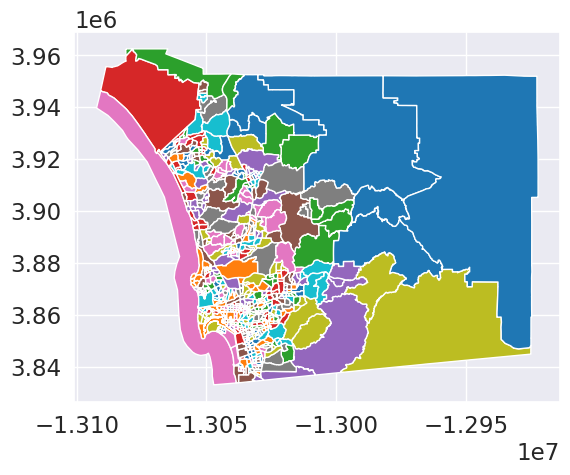

In [150]:
db.plot(column='maxp', categorical=True)

In [156]:
db.explore(column='maxp', tooltip=['maxp', 'total_pop'])

In [152]:
summary = db[['maxp', 'total_pop']].groupby(by='maxp').sum()

In [153]:
summary.head()

,total_pop
maxp,
1,10245.0
2,19651.0
3,10957.0
4,13258.0
5,12708.0


In [70]:
summary.total_pop.describe()

count      279.000000
mean     11769.408602
std       3733.528006
min       8007.000000
25%       9620.000000
50%      10868.000000
75%      12841.500000
max      43376.000000
Name: total_pop, dtype: float64

In [154]:
maxp_hoods = db[['geometry', 'maxp']].dissolve(by='maxp')

In [155]:
maxp_hoods.explore()

In [157]:
import tobler

In [158]:
res = tobler.area_weighted.area_interpolate(db, maxp_hoods, extensive_variables=['total_pop'],
                                   intensive_variables=['pct_white'])

<Axes: >

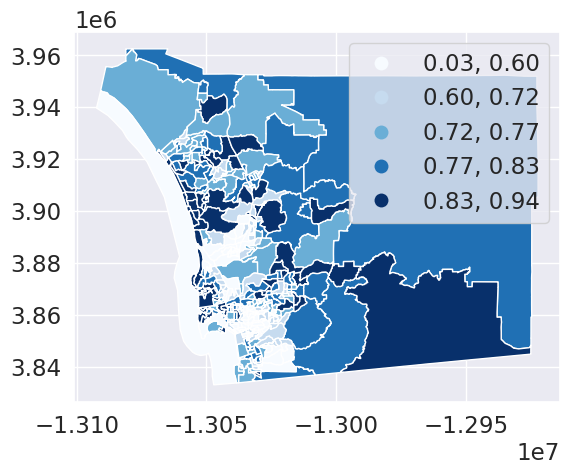

In [159]:
res.plot(column='pct_white', cmap='Blues', legend=True, scheme='quantiles')

In [160]:
res.explore(column='pct_white')